# End to End CatBoost

©️2024 MetaSnake

`@__mharrison__`

In [1]:
!pip install -U catboost

In [ ]:
import catboost
catboost.__version__

'1.2.7'

## Datasets

I'll be demoing with Kaggle 2018 survey data

In [3]:
import pandas as pd
import os
import urllib.request
import zipfile

local = 'kaggle-survey-2018.zip'
if not os.path.exists(local):
    url = 'https://github.com/mattharrison/datasets/raw/master/data/kaggle-survey-2018.zip'
    fin = urllib.request.urlopen(url)
    data = fin.read()
    with open(local, mode='wb') as fout:
        fout.write(data)
with zipfile.ZipFile(local) as z:
    print(z.namelist())
    kag = pd.read_csv(z.open('multipleChoiceResponses.csv'))
    kag_questions = kag.iloc[0]
    raw = kag.iloc[1:]

['multipleChoiceResponses.csv', 'freeFormResponses.csv', 'SurveySchema.csv']


/tmp/ipykernel_3878/3430627780.py:15: DtypeWarning: Columns (0,2,8,10,21,23,24,25,26,27,28,42,44,54,56,64,81,83,85,87,105,107,109,121,123,125,148,150,157,172,174,192,194,210,218,219,221,223,246,247,249,262,264,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,302,304,306,325,326,329,341,368,371,384,385,389,390,391,393,394) have mixed types. Specify dtype option on import or set low_memory=False.
  kag = pd.read_csv(z.open('multipleChoiceResponses.csv'))


In [ ]:
raw

,Time from Start to Finish (seconds),Q1,Q1_OTHER_TEXT,Q2,Q3,Q4,Q5,Q6,Q6_OTHER_TEXT,Q7,...,Q49_OTHER_TEXT,Q50_Part_1,Q50_Part_2,Q50_Part_3,Q50_Part_4,Q50_Part_5,Q50_Part_6,Q50_Part_7,Q50_Part_8,Q50_OTHER_TEXT
1,710,Female,-1,45-49,United States of America,Doctoral degree,Other,Consultant,-1,Other,...,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1
2,434,Male,-1,30-34,Indonesia,Bachelor’s degree,Engineering (non-computer focused),Other,0,Manufacturing/Fabrication,...,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1
3,718,Female,-1,30-34,United States of America,Master’s degree,"Computer science (software engineering, etc.)",Data Scientist,-1,I am a student,...,-1,NaN,Too time-consuming,NaN,NaN,NaN,NaN,NaN,NaN,-1
4,621,Male,-1,35-39,United States of America,Master’s degree,"Social sciences (anthropology, psychology, soc...",Not employed,-1,NaN,...,-1,NaN,NaN,Requires too much technical knowledge,NaN,Not enough incentives to share my work,NaN,NaN,NaN,-1
5,731,Male,-1,22-24,India,Master’s degree,Mathematics or statistics,Data Analyst,-1,I am a student,...,-1,NaN,Too time-consuming,NaN,NaN,Not enough incentives to share my work,NaN,NaN,NaN,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23855,575,Male,-1,45-49,France,Doctoral degree,"Computer science (software engineering, etc.)",Chief Officer,-1,Computers/Technology,...,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1
23856,131,Female,-1,25-29,Turkey,Master’s degree,Engineering (non-computer focused),NaN,-1,NaN,...,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1
23857,370,Male,-1,22-24,Turkey,Master’s degree,"Computer science (software engineering, etc.)",Software Engineer,-1,Computers/Technology,...,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1
23858,36,Male,-1,25-29,United Kingdom of Great Britain and Northern I...,NaN,NaN,NaN,-1,NaN,...,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1


In [5]:
raw.Q4.value_counts().index

Index(['Master’s degree', 'Bachelor’s degree', 'Doctoral degree',
       'Some college/university study without earning a bachelor’s degree',
       'Professional degree', 'I prefer not to answer',
       'No formal education past high school'],
      dtype='object', name='Q4')

In [6]:
raw.Q6.value_counts()

Q6
Student                    5253
Data Scientist             4137
Software Engineer          3130
Data Analyst               1922
Other                      1322
Research Scientist         1189
Not employed                842
Consultant                  785
Business Analyst            772
Data Engineer               737
Research Assistant          600
Manager                     590
Product/Project Manager     428
Chief Officer               360
Statistician                237
DBA/Database Engineer       145
Developer Advocate          117
Marketing Analyst           115
Salesperson                 102
Principal Investigator       97
Data Journalist              20
Name: count, dtype: int64

In [7]:
import pandas as pd
import numpy as np
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, FunctionTransformer
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer

from sklearn import set_config

set_config(transform_output='pandas')

class TopNEncoder(BaseEstimator, TransformerMixin):
    def __init__(self, n=5, default='other'):
        self.n = n
        self.default = default
        self.top_n_categories = None

    def fit(self, X, y=None):
        if isinstance(X, pd.DataFrame):
            X = X.iloc[:, 0]
        counts = X.value_counts()
        self.top_n_categories = set(counts.index[:self.n])
        return self

    def transform(self, X):
        return X.where(X.isin(self.top_n_categories), self.default)

class CustomOneHotEncoder(BaseEstimator, TransformerMixin):
    def __init__(self, drop='first', prefix=None):
        self.drop = drop
        self.prefix = prefix
        self.encoder = None

    def fit(self, X: pd.DataFrame, y=None):
        self.encoder = OneHotEncoder(drop=self.drop, sparse_output=False)
        self.encoder.fit(X)
        return self

    def transform(self, X):
        encoded = self.encoder.transform(X)#.values.reshape(-1, 1))
        return encoded

class AgeExtractor(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return (X
                .assign(**{col: X[col].str.slice(0, 2).astype(int)
                         for col in X.columns})
        )

class EducationEncoder(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.mapping = {
            'I prefer not to answer': None,
            'No formal education past high school': 12,
            'Some college/university study without earning a bachelor’s degree': 13,
            'Bachelor’s degree': 16,
            'Master’s degree': 18,
            'Professional degree': 19,     
            'Doctoral degree':20,
        }

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        if isinstance(X, pd.DataFrame):
            X = X.iloc[:, 0]
        return X.map(self.mapping).to_frame()

class ExperienceExtractor(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return (pd.DataFrame(X)
            .assign(
                experience=lambda df: (
                    df.iloc[:, 0]
                    .str.replace('+', '', regex=False)
                    .str.split('-', expand=True)
                    .iloc[:, 0]
                    .astype(float)
                )
            )
            .loc[:, ['experience']]
        )


class CompensationExtractor(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return (pd.DataFrame(X)
            .assign(
                compensation=lambda df: (
                    df.iloc[:, 0]
                    .str.replace('+', '', regex=False)
                    .str.replace(',', '', regex=False)
                    .str.replace('500000', '500', regex=False)
                    .str.replace('I do not wish to disclose my approximate yearly compensation', '0', regex=False)
                    .str.split('-', expand=True)
                    .iloc[:, 0]
                    .fillna(0)
                    .astype(int)
                    .mul(1000)
                )
            )
            .loc[:, ['compensation']]
        )

class LanguageEncoder(BaseEstimator, TransformerMixin):
    def __init__(self, language):
        self.language = language

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        if isinstance(X, pd.DataFrame):
            X = X.iloc[:, 0]
        return X.fillna(0).map({self.language: 1}).rename(self.language).to_frame()

def create_pipeline():
    gender_encoder = CustomOneHotEncoder(drop='first', prefix='gender')
    country_encoder = CustomOneHotEncoder(drop='first', prefix='country')
    major_encoder = Pipeline([
        ('topn', TopNEncoder(n=3)),
        ('replace', FunctionTransformer(lambda X: X.iloc[:, 0].map({
            'Computer science (software engineering, etc.)': 'cs',
            'Engineering (non-computer focused)': 'eng',
            'Mathematics or statistics': 'stat'
        }).to_frame())),
        ('onehot', CustomOneHotEncoder(drop='first', prefix='major'))
    ])

    preprocessor = ColumnTransformer([
        ('gender', gender_encoder, ['Q1']),
        ('age', AgeExtractor(), ['Q2']),
        ('country', country_encoder, ['Q3']),
        ('education', EducationEncoder(), ['Q4']),
        ('major', major_encoder, ['Q5']),
        ('years_exp', ExperienceExtractor(), ['Q8']),
        ('compensation', CompensationExtractor(), ['Q9']),
        ('python', LanguageEncoder('Python'), ['Q16_Part_1']),
        ('r', LanguageEncoder('R'), ['Q16_Part_2']),
        ('sql', LanguageEncoder('SQL'), ['Q16_Part_3'])
    ])

    pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('imputer', SimpleImputer(strategy='mean'))
    ])

    return pipeline

# Usage
pipeline = create_pipeline()
kag_X_transformed = pipeline.fit_transform(
    raw[raw.Q3.isin(["United States of America", "China", "India"])]
)
kag_y = (raw
         .loc[kag_X_transformed.index]
            .query('Q6 == "Data Scientist" or Q6 == "Software Engineer"')
            .loc[:, 'Q6']
)
kag_X = kag_X_transformed.loc[kag_y.index]

# Split the data
from sklearn.model_selection import train_test_split
kag_X_train, kag_X_test, kag_y_train, kag_y_test = train_test_split(
    kag_X, kag_y, stratify=kag_y, random_state=42)

In [8]:
kag_X

,gender__Q1_Male,gender__Q1_Prefer not to say,gender__Q1_Prefer to self-describe,age__Q2,country__Q3_India,country__Q3_United States of America,education__Q4,major__Q5_eng,major__Q5_stat,major__Q5_nan,years_exp__experience,compensation__compensation,python__Python,r__R,sql__SQL
3,0.0,0.0,0.0,30.0,0.0,1.0,18.0,0.0,0.0,0.0,0.00000,0.0,1.0,1.0,1.0
12,1.0,0.0,0.0,40.0,0.0,1.0,18.0,1.0,0.0,0.0,5.00000,125000.0,1.0,1.0,1.0
37,1.0,0.0,0.0,40.0,1.0,0.0,16.0,1.0,0.0,0.0,10.00000,0.0,1.0,1.0,1.0
41,1.0,0.0,0.0,40.0,0.0,1.0,20.0,0.0,0.0,0.0,10.00000,400000.0,1.0,1.0,1.0
52,1.0,0.0,0.0,18.0,1.0,0.0,16.0,0.0,0.0,0.0,0.00000,0.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23684,1.0,0.0,0.0,18.0,1.0,0.0,18.0,0.0,0.0,0.0,0.00000,0.0,1.0,1.0,1.0
23712,0.0,0.0,0.0,25.0,1.0,0.0,18.0,0.0,0.0,0.0,3.00000,0.0,1.0,1.0,1.0
23792,0.0,0.0,0.0,25.0,1.0,0.0,16.0,0.0,0.0,0.0,3.65193,0.0,1.0,1.0,1.0
23796,1.0,0.0,0.0,22.0,1.0,0.0,18.0,1.0,0.0,0.0,1.00000,0.0,1.0,1.0,1.0


In [9]:
kag_y

3           Data Scientist
12          Data Scientist
37       Software Engineer
41       Software Engineer
52          Data Scientist
               ...        
23684    Software Engineer
23712    Software Engineer
23792    Software Engineer
23796    Software Engineer
23813       Data Scientist
Name: Q6, Length: 3015, dtype: object

In [10]:
# check for missing values
kag_y.isna().pipe(lambda s: s[s > 0])

Series([], Name: Q6, dtype: bool)

## Use PCA to Visualize

In [11]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('std', StandardScaler()), ('pca', PCA(n_components=3))])
X_pca = pca_pipeline.fit_transform(kag_X)
pca = pca_pipeline.named_steps['pca']

In [12]:
X_pca

,pca0,pca1,pca2
3,0.624715,-1.591814,0.919553
12,1.698293,1.463576,0.490005
37,-1.022842,2.829256,0.983715
41,4.192900,1.270116,-0.427639
52,-2.386065,-0.236546,-0.510171
...,...,...,...
23684,-2.055741,-0.360391,-0.282792
23712,-1.354210,-0.794842,1.265514
23792,-1.647545,-0.593391,1.056221
23796,-2.032601,0.725592,0.614537


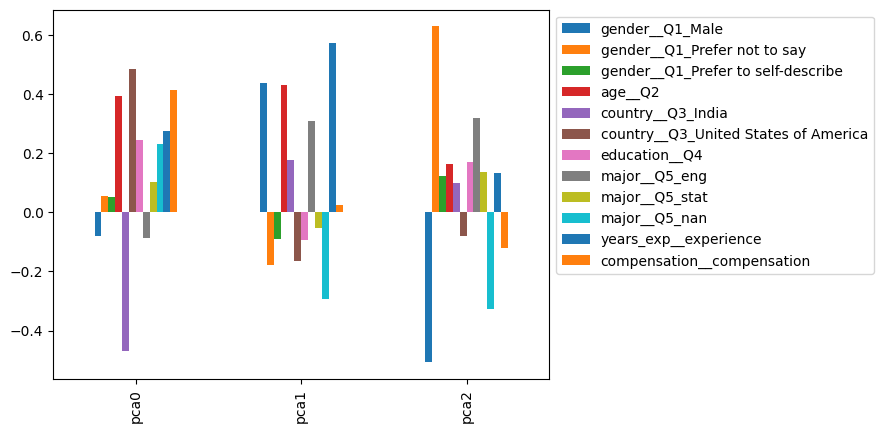

In [13]:
# components

(pd.DataFrame(pca.components_, columns=kag_X.columns,
              index=[f'pca{i}' for i in range(pca.n_components_ )])
.loc[:, lambda df: (df.abs() > .1).any(axis='index')]
.plot.bar()
.legend(bbox_to_anchor=(1,1))              
)

In [14]:
import plotly.express as px
fig = px.scatter_3d(data:=X_pca.assign(**kag_X),
                x='pca0', y='pca1', z='pca2',
                #color='age__Q2',
                #color='major__experience',
                #color='education__Q4',
                color='compensation__compensation',
                  hover_data=data.columns,
                color_continuous_scale='viridis')
fig.update_layout(
    width=800,
    height=600,
    title='3D PCA Scatter Plot'
)      
fig.update_traces(marker=dict(size=3))

fig.show()

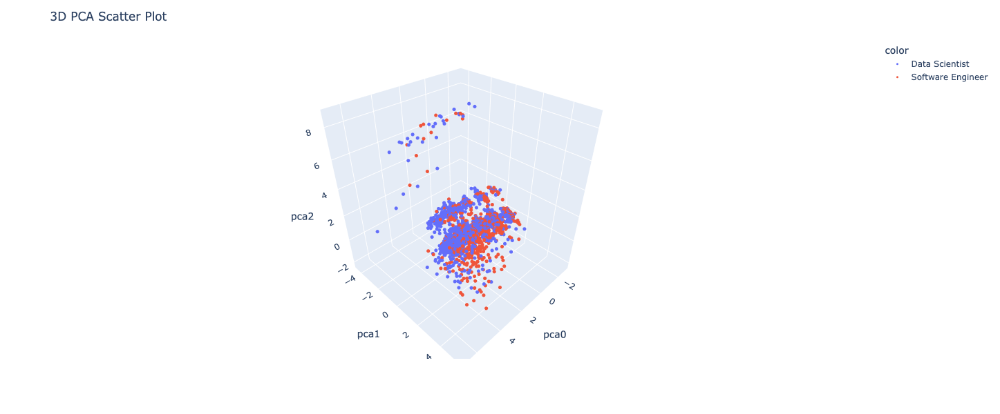

In [13]:
# color by job title
import plotly.express as px
fig = px.scatter_3d(data:=X_pca.assign(**kag_X),
                x='pca0', y='pca1', z='pca2',
                color=kag_y, hover_data=data.columns,
                color_continuous_scale='viridis')
fig.update_layout(
    width=800,
    height=600,
    title='3D PCA Scatter Plot'
)      
fig.update_traces(marker=dict(size=3))

fig.show()

## Stumps, Trees, and Forests

In [15]:
X = (raw.loc[
    raw.Q3.isin(["United States of America", "China", "India"])
    & raw.Q6.isin(["Data Scientist", "Software Engineer"]),
    ['Q1', 'Q2', 'Q3', 'Q4', 'Q5', 'Q8', 'Q9', 'Q16_Part_1', 'Q16_Part_2', 'Q16_Part_3']]
    .rename(columns={'Q1': 'gender', 'Q2': 'age', 'Q3': 'country', 'Q4': 'education', 
                     'Q5': 'major', 'Q8': 'years_exp', 'Q9': 'compensation', 
                     'Q16_Part_1': 'python', 'Q16_Part_2': 'r', 'Q16_Part_3': 'sql'})
    .fillna('NA')  # categories can't have missing values
    # not strictly required to convert to category, but it will save memory (generally)
    #.pipe(lambda df: df.assign(**df.select_dtypes('object').astype('category')))    
)
y = (raw
        .loc[X.index]
        .loc[:, 'Q6']
    )

In [16]:
X

,gender,age,country,education,major,years_exp,compensation,python,r,sql
3,Female,30-34,United States of America,Master’s degree,"Computer science (software engineering, etc.)",0-1,"0-10,000",NA,R,NA
12,Male,40-44,United States of America,Master’s degree,Engineering (non-computer focused),5-10,"125-150,000",Python,NA,SQL
37,Male,40-44,India,Bachelor’s degree,Engineering (non-computer focused),10-15,I do not wish to disclose my approximate yearl...,Python,R,NA
41,Male,40-44,United States of America,Doctoral degree,"Computer science (software engineering, etc.)",10-15,"400-500,000",Python,NA,NA
52,Male,18-21,India,Bachelor’s degree,"Computer science (software engineering, etc.)",0-1,"0-10,000",Python,NA,NA
...,...,...,...,...,...,...,...,...,...,...
23684,Male,18-21,India,Master’s degree,"Computer science (software engineering, etc.)",0-1,I do not wish to disclose my approximate yearl...,NA,NA,NA
23712,Female,25-29,India,Master’s degree,"Computer science (software engineering, etc.)",3-4,"0-10,000",Python,NA,SQL
23792,Female,25-29,India,Bachelor’s degree,"Computer science (software engineering, etc.)",NA,NA,NA,NA,NA
23796,Male,22-24,India,Master’s degree,Engineering (non-computer focused),1-2,I do not wish to disclose my approximate yearl...,NA,NA,NA


In [17]:
y

3           Data Scientist
12          Data Scientist
37       Software Engineer
41       Software Engineer
52          Data Scientist
               ...        
23684    Software Engineer
23712    Software Engineer
23792    Software Engineer
23796    Software Engineer
23813       Data Scientist
Name: Q6, Length: 3015, dtype: object

In [18]:
y.value_counts()

Q6
Data Scientist       1647
Software Engineer    1368
Name: count, dtype: int64

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)

In [20]:
stump = catboost.CatBoostClassifier(iterations=1, depth=1, 
                                    cat_features=list(X_train.columns))
stump.fit(X_train, y_train)


Learning rate set to 0.5
0:	learn: 0.6503788	total: 56.3ms	remaining: 0us


In [21]:
stump.score(X_test, y_test)

0.623342175066313

In [22]:
# on an underfit model, we generally see similar (bad) performance on the training set
stump.score(X_train, y_train)

0.6306943830163645

In [23]:
stump.classes_

array(['Data Scientist', 'Software Engineer'], dtype=object)

In [24]:
# This fails without a CatBoost "Pool"
stump.plot_tree(tree_idx=0)

CatBoostError: catboost/private/libs/algo/tree_print.cpp:216: Please pass training dataset to plot_tree function, training dataset is required if categorical features are present in the model.

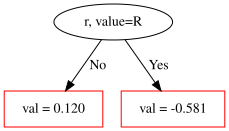

In [27]:
# On codespaces run:
# sudo apt-get update
# sudo apt-get install graphviz
pool = catboost.Pool(X_train, y_train, cat_features=list(X_train.columns))
res = stump.plot_tree(tree_idx=0, pool=pool)
res

## Hyperparameters

In [25]:
# sort the keys so that the order is consistent
# .get_all_params() returns all of the parameters
unsorted_dict = stump.get_all_params()
sorted_dict = dict(sorted(unsorted_dict.items()))
sorted_dict 

{'auto_class_weights': 'None',
 'bayesian_matrix_reg': 0.10000000149011612,
 'best_model_min_trees': 1,
 'boost_from_average': False,
 'boosting_type': 'Plain',
 'bootstrap_type': 'MVS',
 'border_count': 254,
 'class_names': ['Data Scientist', 'Software Engineer'],
 'classes_count': 0,
 'combinations_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1',
  'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1'],
 'counter_calc_method': 'SkipTest',
 'ctr_leaf_count_limit': 18446744073709551615,
 'ctr_target_border_count': 1,
 'depth': 1,
 'eval_fraction': 0,
 'eval_metric': 'Logloss',
 'feature_border_type': 'GreedyLogSum',
 'fold_permutation_block': 0,
 'force_unit_auto_pair_weights': False,
 'grow_policy': 'SymmetricTree',
 'has_time': False,
 'iterations': 1,
 'l2_leaf_reg': 3,
 'leaf_estimation_backtracking': 'AnyImprovement',
 'leaf_estimation_iterations': 1,
 'leaf_estimation_method': 'Newton',

## Underfit

A stump is too simple. It has too much *bias*.

Solutions:

- Add better features
- Use a more complex model

If we let the tree grow, it will do both of these things.

## Overfit

A model that is too complex has too much *variance*.

Solutions:

- Simplify the model (or constrain/regularize it)
- Use more data

IF a tree is too complex, we can prune it so that the leaf nodes are not too specific.

In [28]:
var_settings = catboost_config = {
    'auto_class_weights': 'None',
    #'bayesian_matrix_reg': 0,  # Reduced from 0.10000000149011612
    'best_model_min_trees': 1,
    'boost_from_average': False,
    'boosting_type': 'Plain',
    #'bootstrap_type': 'No',  # Changed from 'MVS'
    'border_count': 1024, #254,
    #'class_names': ['Data Scientist', 'Software Engineer'],
    'classes_count': 0,
    'combinations_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1',
     'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1'],
    'counter_calc_method': 'SkipTest',
    'ctr_leaf_count_limit': 18446744073709551615,
    'ctr_target_border_count': 1,
    #'depth': None,  # Changed from 1 to None (unlimited depth)
    'eval_fraction': 0,
    'eval_metric': 'Logloss',
    'feature_border_type': 'GreedyLogSum',
    'fold_permutation_block': 0,
    #'force_unit_auto_pair_weights': False,
    'grow_policy': 'SymmetricTree',
    'has_time': False,
    #'iterations': 1000,  # Increased from 1
    'l2_leaf_reg': 0,  # Reduced from 3
    'leaf_estimation_backtracking': 'No',  # Changed from 'AnyImprovement'
    'leaf_estimation_iterations': 10,  # Increased from 1
    'leaf_estimation_method': 'Newton',
    'learning_rate': 1,  # Increased from 0.5
    'loss_function': 'Logloss',
    'max_ctr_complexity': 8,  # Increased from 1
    'max_leaves': None, #31,  # Increased from 2
    'min_data_in_leaf': 1,
    'model_shrink_mode': 'Constant',
    'model_shrink_rate': 0,
    'model_size_reg': 0,  # Reduced from 0.5
    'nan_mode': 'Min',
    'one_hot_max_size': 2,
    'penalties_coefficient': 1,
    #'permutation_count': 1,  # Reduced from 4
    #'pool_metainfo_options': {'tags': {}},
    'posterior_sampling': False,
    'random_score_type': 'NormalWithModelSizeDecrease',
    'random_seed': 0,
    'random_strength': 0,  # Reduced from 1
    'rsm': 1,
    'sampling_frequency': 'PerTree',
    'score_function': 'Cosine',
    'simple_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1',
     'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1'],
    'sparse_features_conflict_fraction': 0,
    'store_all_simple_ctr': False,
    'subsample': 1,  # Increased from 0.800000011920929
    'task_type': 'CPU',
    'use_best_model': False
}


In [29]:
# fails because CatBoost has a depth limit of 16
hi_variance = catboost.CatBoostClassifier(iterations=1, depth=100, **var_settings,
                                            cat_features=list(X_train.columns))
hi_variance.fit(X_train, y_train)

CatBoostError: catboost/private/libs/options/oblivious_tree_options.cpp:128: Maximum tree depth is 16

In [30]:
# plotting the tree fails if the depth > 13 (on my mac)
hi_variance = catboost.CatBoostClassifier(iterations=1, depth=13, **var_settings,
                        cat_features=list(X_train.columns))
hi_variance.fit(X_train, y_train)


0:	learn: 0.3227946	total: 105ms	remaining: 0us


In [31]:
hi_variance.score(X_test, y_test)

0.6724137931034483

In [32]:
hi_variance.score(X_train, y_train)

0.7386112339672711

In [33]:
print(f'Res={hi_variance._object._is_oblivious()}')

Res=True


In [34]:
# note that the tree is "oblivious". This means that at every level of the tree,
# the feature that is split on is the same.
# - These work better with categorical data
# - They are also faster to train
# - Easier to regularize
hi_variance.plot_tree(tree_idx=0, pool=pool)

## Goldilocks

We want a model that is just right.

0:	learn: 0.6321184	total: 1.4ms	remaining: 0us
0:	learn: 0.5946099	total: 1.29ms	remaining: 0us
0:	learn: 0.5774134	total: 1.8ms	remaining: 0us
0:	learn: 0.5631440	total: 3.1ms	remaining: 0us
0:	learn: 0.5571680	total: 2.52ms	remaining: 0us
0:	learn: 0.5520745	total: 3.44ms	remaining: 0us
0:	learn: 0.5320047	total: 6.22ms	remaining: 0us
0:	learn: 0.5181285	total: 8.26ms	remaining: 0us
0:	learn: 0.4937329	total: 15.5ms	remaining: 0us
0:	learn: 0.4549941	total: 19.4ms	remaining: 0us
0:	learn: 0.4129310	total: 31ms	remaining: 0us
0:	learn: 0.3709535	total: 55.6ms	remaining: 0us
0:	learn: 0.3227946	total: 113ms	remaining: 0us
0:	learn: 0.2593551	total: 231ms	remaining: 0us
0:	learn: 0.2199194	total: 477ms	remaining: 0us


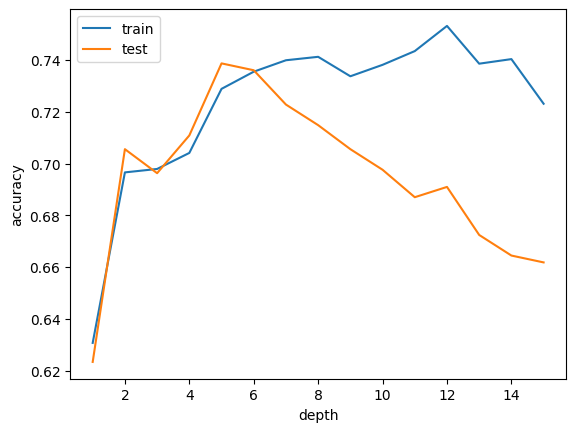

In [35]:
train_scores = []
test_scores = []
for i in range(1, 16):
    goldilocks = catboost.CatBoostClassifier(iterations=1, depth=i, **var_settings,
                                            cat_features=list(X_train.columns))
    goldilocks.fit(X_train, y_train)
    train_scores.append(goldilocks.score(X_train, y_train))
    test_scores.append(goldilocks.score(X_test, y_test))

import matplotlib.pyplot as plt
plt.plot(range(1, 16), train_scores, label='train')
plt.plot(range(1, 16), test_scores, label='test')
plt.xlabel('depth')
plt.ylabel('accuracy')
plt.legend()

In [36]:
gold5 = catboost.CatBoostClassifier(iterations=1, depth=5, **var_settings,
                                    cat_features=list(X_train.columns))
gold5.fit(X_train, y_train)
gold5.score(X_test, y_test)

0:	learn: 0.5571680	total: 2.87ms	remaining: 0us


0.7387267904509284

In [38]:
gold5.score(X_train, y_train)

0.7288810260946483

## CatBoost

CatBoost uses *boosting* to train a series of symmetric (oblivious) decision trees, where each tree tries to correct the mistakes made by the previous one. For classification tasks, this process refines the prediction into a probability.

Imagine it like golfing: after each shot (tree), you adjust your next move to get closer to the hole (correct prediction). In contrast, a decision tree is like hitting one ball and stopping. A random forest would be like taking multiple tee shots and averaging them to find the best one.

- *Automatic Handling of Categorical Features*: CatBoost natively supports categorical features, encoding them in a highly efficient way without the need for preprocessing.
- *Missing Value Support*: CatBoost handles missing data for numeric data automatically. (It does not support missing categorical data.)
- *Overfitting Detection*: To prevent overfitting, CatBoost can stop training early when it detects that the model is no longer improving.
- *Embedding Features*: You can specify that a group of columns should be treated as an embedding feature, which can improve the model's performance.


In [39]:
# This is the out of the box model. Note that it performs much better than 
# goldilocks
cat1 = catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False)
cat1.fit(X_train, y_train)
cat1.score(X_test, y_test)

0.7506631299734748

In [40]:
cat1.score(X_train, y_train)

0.784608580274215

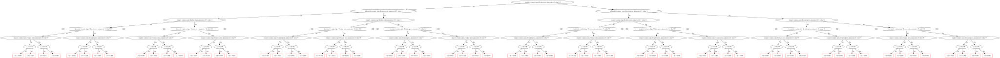

In [41]:
# plot tree 1
cat1.plot_tree(tree_idx=0, pool=pool)


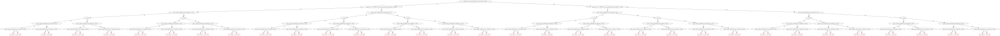

In [41]:
# plot tree 2
cat1.plot_tree(tree_idx=1, pool=pool)


In [42]:
X_test.iloc[0]

gender                                                   Male
age                                                     25-29
country                                                 India
education                                     Master’s degree
major           Computer science (software engineering, etc.)
years_exp                                                 1-2
compensation                                         0-10,000
python                                                 Python
r                                                          NA
sql                                                       SQL
Name: 5525, dtype: object

In [43]:
print([x for x in dir(cat1) if x.endswith('_')])

['__class__', '__copy__', '__deepcopy__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setstate__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_is_fitted_', 'best_iteration_', 'best_score_', 'classes_', 'evals_result_', 'feature_importances_', 'feature_names_', 'learning_rate_', 'n_features_in_', 'random_seed_', 'tree_count_']


## Tree Hyperparameters

## **Model Architecture and Tree Structure**

- **`boosting_type='Plain'`**: Type of boosting algorithm. `'Plain'` means no boosting over time or residuals.
  
- **`grow_policy='SymmetricTree'`**: Strategy for growing trees. Symmetric trees split all branches at a given depth on the same feature, ensuring a balanced structure.

- **`depth=None`**: Depth of the trees. Setting `None` means unlimited depth, allowing trees to grow without restrictions. *Changed from 1 to None*.

- **`max_leaves=None`**: The maximum number of leaves in a tree. *Increased from 2 to None* (no limit).

---

## **Feature Sampling and Processing**

- **`rsm=1`**: Random subspace method. Controls the fraction of features considered for splits. Set to 1, meaning all features are used for splitting.

- **`border_count=1024`**: Number of splits for numeric features. A high value (1024) allows more precise splits. *Increased from 254*.

- **`max_ctr_complexity=8`**: Maximum complexity of combinatorial feature transformations for categorical features. *Increased from 1*.

- **`feature_border_type='GreedyLogSum'`**: Strategy for selecting borders (thresholds) when binning numeric features. `'GreedyLogSum'` uses a greedy logarithmic sum approach.

- **`one_hot_max_size=2`**: Maximum number of unique categorical values for which one-hot encoding is used. For categories larger than this, other methods are applied.

---

## **Categorical Feature Handling**

- **`combinations_ctr=['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1']`**: Control how categorical features are processed using combinatorial counters and borders.
  
- **`ctr_leaf_count_limit=18446744073709551615`**: Limits the maximum number of leaves used for categorical feature transformation. The large value effectively disables this limit.

- **`ctr_target_border_count=1`**: Sets the number of target borders used in categorical target statistics. Helps to limit the complexity of categorical features.

---

## **Regularization and Overfitting Prevention**

- **`l2_leaf_reg=0`**: L2 regularization coefficient applied to leaf values. A lower value like 0 reduces regularization, allowing more variance. *Reduced from 3*.

- **`random_strength=0`**: Strength of random noise added to splits' scores. Zero means no randomization, making the model more deterministic. *Reduced from 1*.

- **`model_shrink_rate=0`**: Shrinkage rate for model weights during training. Zero means no shrinkage. *Reduced from 0.5*.

- **`model_size_reg=0`**: Regularization coefficient for model size. A lower value like 0 disables this regularization. *Reduced from 0.5*.

---

## **Tree Estimation and Leaf Calculations**

- **`leaf_estimation_iterations=10`**: Number of gradient steps used to estimate the leaf values. *Increased from 1 to 10*.

- **`leaf_estimation_method='Newton'`**: Method for leaf value estimation. Uses Newton-Raphson method for faster convergence.

- **`leaf_estimation_backtracking='No'`**: Specifies backtracking behavior during leaf value estimation. `'No'` disables any backtracking. *Changed from 'AnyImprovement'*.

---

## **Learning Rate and Convergence**

- **`learning_rate=1`**: Step size used in gradient boosting. A higher learning rate speeds up training but risks overfitting. *Increased from 0.5*.

---

## **Loss Function and Metrics**

- **`loss_function='Logloss'`**: Loss function used for binary classification, which minimizes the log loss.

- **`eval_metric='Logloss'`**: Metric to evaluate during model training, matching the loss function used.

---

## **Data Handling**

- **`auto_class_weights='None'`**: No automatic class weight balancing. This assumes that class distribution in the data is balanced.

- **`eval_fraction=0`**: Fraction of data used for evaluation. A value of `0` indicates no separate evaluation set.

- **`subsample=1`**: Fraction of data used for training each tree. A value of 1 means no subsampling. *Increased from 0.8*.

---

## **Cross-Validation and Permutations**

- **`fold_permutation_block=0`**: Specifies block size for folding data during cross-validation. A value of 0 disables folding by blocks.

- **`counter_calc_method='SkipTest'`**: Method used for calculating counter features. `'SkipTest'` means counters are calculated only on training data.

- **`posterior_sampling=False`**: Disables posterior sampling for Bayesian-like updates of leaf values.

---

## **Scoring and Bootstrapping**

- **`score_function='Cosine'`**: The scoring function used to evaluate splits. `'Cosine'` computes the cosine similarity between vectors.

- **`sampling_frequency='PerTree'`**: Frequency for resampling data. `PerTree` means resampling occurs once per tree, which adds randomness.

---

## **Bootstrapping and Shrinkage**

- **`boost_from_average=False`**: Whether to initialize leaf values from the mean of the target variable. Setting it to `False` can help with imbalanced datasets.

- **`best_model_min_trees=1`**: Minimum number of trees required to determine the best model. *Set to 1*.

---

## **Randomness and Reproducibility**

- **`random_seed=0`**: Seed for random number generation to ensure reproducibility.

- **`random_score_type='NormalWithModelSizeDecrease'`**: Type of randomness to introduce in scoring during splits. This type introduces noise proportional to model size.

---

## **Additional Configurations**

- **`penalties_coefficient=1`**: Penalty coefficient applied to regularization terms, set to 1 for no additional penalties.

- **`task_type='CPU'`**: Specifies the type of processor to use for training (CPU-based training).

- **`use_best_model=False`**: Disables the automatic selection of the best model during training.

- **`nan_mode='Min'`**: Specifies how to handle missing values (NaN). `'Min'` treats missing values as the smallest possible values.

---

## Which Parameters to tune?

| Parameter | Description | CB1 | CB2 | CB_tut | AWS | Forecastegy | Optuna |
| --- | --- | --- | --- | --- | --- | --- | --- |
| `learning_rate` | Step size used in gradient boosting | X | X | X | X | X | |
| `random_strength` | Strength of random noise added to splits' scores | X | X |  | X | | |
| `one_hot_max_size` | Maximum number of unique categorical values for which one-hot encoding is used | X |  |  |  | | |
| `l2_leaf_reg` | L2 regularization coefficient applied to leaf values | X | X | X | X | | |
| `bagging_temperature` | Controls the intensity of sampling | X | X |  |  |  | |
| `iterations` | Number of trees to build | X | X |  |  | X | |
| `use_best_model` | Use the best model found during training |  | X |  |  | | |
| `eval_metric` | Metric to evaluate during model training |  | X |  |  | | X |
| `od_type` | Type of overfitting detector to use |  | X |  |  | | |
| `od_pval` | Threshold for the overfitting detector |  | X |  |  | | |
| `od_wait` | Number of iterations to continue training after overfitting is detected |  | X |  |  | | |
| `depth` | Depth of the trees |  | X | X | X | X | X |
| `border_count` | Number of splits for numeric features |  | X |  |  | | |
| `has_time` | Use time as a feature (data has time order) |  | X |  |  | | |
| `grow_policy` | Strategy for growing trees |  | X |  |  | | |
| `min_data_in_leaf` | Minimum number of training samples in a leaf |  | X |  |  | X | |
| `max_leaves` | Maximum number of leaves in a tree |  | X |  |  | | |
| `per_float_feature_quantization` | Number of bits to use for quantizing numerical features |  | X |  |  | | |
| `max_ctr_complexity` | Maximum complexity of combinatorial feature transformations for categorical features |  |  | X |  | |  |  
| `boosting_type` | Type of boosting algorithm |  |  | X |  | |  X |
| `subsample` | Fraction of data used for training each tree |  |  |  |  | X | |
| `col_sample_bylevel` | Fraction of features to consider for each level |  |  |  |  | X | X |
| `bootstrap_type` | Sampling method for bagging |  |  |  |  | |  X |
| `used_ram_limit` | Maximum amount of RAM to use for training |  |  |  |  | |  X |
| `objective` | Objective function to optimize |  |  |  |  | | X |


Taken from:
- CB1 - CatBoost PDF 
- CB2 - https://catboost.ai/en/docs/concepts/parameter-tuning
- CB_tut - https://github.com/catboost/tutorials/blob/master/hyperparameters_tuning/hyperparameters_tuning_using_optuna_and_hyperopt.ipynb
- AWS - https://docs.aws.amazon.com/sagemaker/latest/dg/catboost-tuning.html
- Forecastegy - https://forecastegy.com/posts/catboost-hyperparameter-tuning-guide-with-optuna/
- Optuna - https://github.com/optuna/optuna-examples/blob/main/catboost/catboost_pruning.py

findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the fo

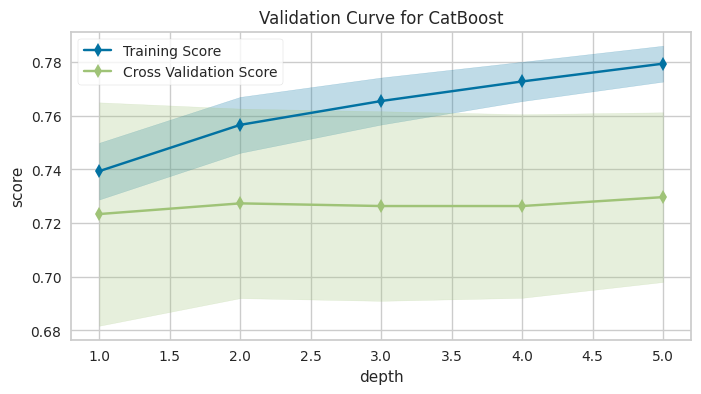

ValidationCurve(ax=<Axes: title={'center': 'Validation Curve for CatBoost'}, xlabel='depth', ylabel='score'>,
                estimator=<catboost.core.CatBoostClassifier object at 0x7c31ac883950>,
                param_name='depth', param_range=array([1, 2, 3, 4, 5]))

In [44]:
# takes about 45 seconds to run
import matplotlib.pyplot as plt
from yellowbrick import model_selection as ms
from yellowbrick.utils import types, helpers
from yellowbrick import base

base.get_model_name = lambda model: 'CatBoost'
#helpers.is_esitmator = lambda model: print(f'calling {model=}') or True

fig, ax = plt.subplots(figsize=(8,4))
ms.validation_curve(catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False),
                    X, y, param_name='depth', param_range=range(1,6))
            

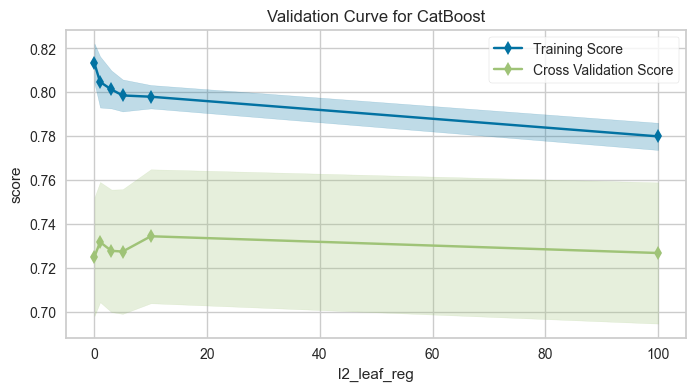

ValidationCurve(ax=<AxesSubplot: title={'center': 'Validation Curve for CatBoost'}, xlabel='l2_leaf_reg', ylabel='score'>,
                estimator=<catboost.core.CatBoostClassifier object at 0x2928e93f0>,
                param_name='l2_leaf_reg',
                param_range=array([  0,   1,   3,   5,  10, 100]))

In [24]:
# takes about 90 seconds to run
import matplotlib.pyplot as plt
from yellowbrick import model_selection as ms
from yellowbrick.utils import types, helpers
from yellowbrick import base

base.get_model_name = lambda model: 'CatBoost'
#helpers.is_esitmator = lambda model: print(f'calling {model=}') or True

fig, ax = plt.subplots(figsize=(8,4))
ms.validation_curve(catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False),
                    X, y, param_name='l2_leaf_reg', param_range=[0, 1, 3, 5, 10, 100])
            

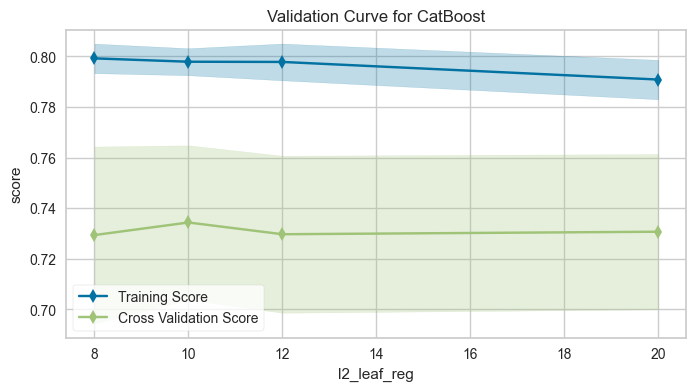

ValidationCurve(ax=<AxesSubplot: title={'center': 'Validation Curve for CatBoost'}, xlabel='l2_leaf_reg', ylabel='score'>,
                estimator=<catboost.core.CatBoostClassifier object at 0x2929b31c0>,
                param_name='l2_leaf_reg', param_range=array([ 8, 10, 12, 20]))

In [25]:
# takes about 90 seconds to run
import matplotlib.pyplot as plt
from yellowbrick import model_selection as ms
from yellowbrick.utils import types, helpers
from yellowbrick import base

base.get_model_name = lambda model: 'CatBoost'
#helpers.is_esitmator = lambda model: print(f'calling {model=}') or True

fig, ax = plt.subplots(figsize=(8,4))
ms.validation_curve(catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False),
                    X, y, param_name='l2_leaf_reg', param_range=[8, 10, 12, 20])
            

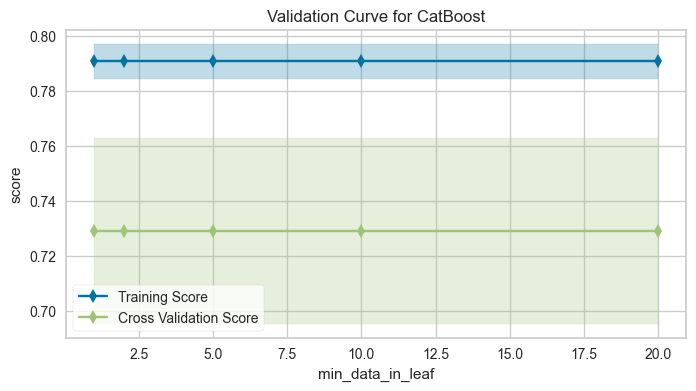

ValidationCurve(ax=<AxesSubplot: title={'center': 'Validation Curve for CatBoost'}, xlabel='min_data_in_leaf', ylabel='score'>,
                estimator=<catboost.core.CatBoostClassifier object at 0x293b3f250>,
                param_name='min_data_in_leaf',
                param_range=array([ 1,  2,  5, 10, 20]))

In [27]:
# takes about 90 seconds to run
import matplotlib.pyplot as plt
from yellowbrick import model_selection as ms
from yellowbrick.utils import types, helpers
from yellowbrick import base

base.get_model_name = lambda model: 'CatBoost'
#helpers.is_esitmator = lambda model: print(f'calling {model=}') or True

fig, ax = plt.subplots(figsize=(8,4))
ms.validation_curve(catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False),
                    X, y, param_name='min_data_in_leaf', param_range=[1, 2, 5, 10, 20])
            

In [29]:
%%time
from sklearn import model_selection
# this takes a while to run (about 2 minutes)
# can set scoring in GridSearchCV to 
# recall, precision, f1, accuracy
params = {
          'learning_rate': [.1, .3], # makes each boost more conservative (0 - no shrinkage) 
          'random_strength': [.5, 1, 2],
          'one_hot_max_size': [1, 32, 64],
          #'gamma': [0, 1],
          'l2_leaf_reg': [0, 1, 2],
          
          'bagging_temperature': [0, 1],
          #'early_stopping_rounds':[10],
          'n_estimators': [200]}
cb3 = catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False)
cv = (model_selection.GridSearchCV(cb3, params, cv=3)#, n_jobs=-1)
    .fit(X, y)
#         eval_set=[(kag_X_test, kag_y_test)],
 #        early_stopping_rounds=5, verbose=10) 
     )

CPU times: user 4min 5s, sys: 1min 55s, total: 6min
Wall time: 1min 42s


In [30]:
bcv.best_params_

{'bagging_temperature': 0,
 'l2_leaf_reg': 2,
 'learning_rate': 0.1,
 'n_estimators': 200,
 'one_hot_max_size': 1,
 'random_strength': 0.5}

In [46]:
params = {'bagging_temperature': 0,
 'l2_leaf_reg': 2,
 'learning_rate': 0.1,
 'n_estimators': 200,
 'one_hot_max_size': 1,
 'random_strength': 0.5}
cb4 = catboost.CatBoostClassifier(**params, cat_features=list(X_train.columns), verbose=False)
cb4.fit(X_train, y_train)
cb4.score(X_test, y_test)

0.7480106100795756

In [45]:
cb_def = catboost.CatBoostClassifier( cat_features=list(X_train.columns), verbose=False)
cb_def.fit(X_train, y_train)
cb_def.score(X_test, y_test)

0.7559681697612732

In [46]:
# note with tuned XGBoost model, I get 0.7253814147018031

## Model Evaluation
Now that we've tuned our model, let's look at how it performs

In [47]:
from sklearn import metrics
metrics.accuracy_score(y_test, cb4.predict(X_test))

0.7480106100795756

In [ ]:
metrics.precision_score(y_test, cb4.predict(X_test))

ValueError: pos_label=1 is not a valid label. It should be one of ['Data Scientist', 'Software Engineer']

In [49]:
cb4.classes_

array(['Data Scientist', 'Software Engineer'], dtype=object)

In [ ]:
metrics.precision_score(y_test, cb4.predict(X_test), pos_label='Software Engineer')

0.6979166666666666

In [ ]:
metrics.recall_score(y_test, cb4.predict(X_test), pos_label='Software Engineer')

0.783625730994152

In [52]:
metrics.f1_score(y_test, cb4.predict(X_test), pos_label='Software Engineer')

0.7382920110192838

findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the fo

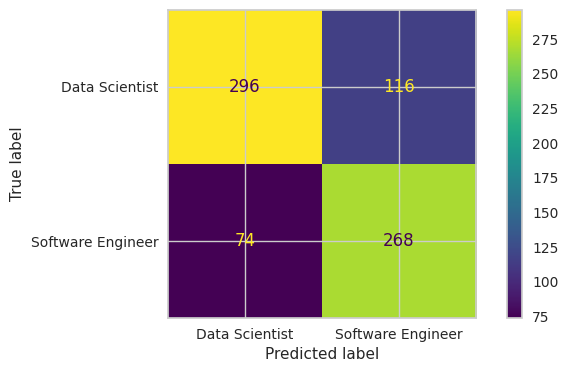

In [53]:
fig, ax = plt.subplots(figsize=(8,4))
metrics.ConfusionMatrixDisplay.from_estimator(cb4,
                       X_test, y_test,ax=ax)

findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the fo

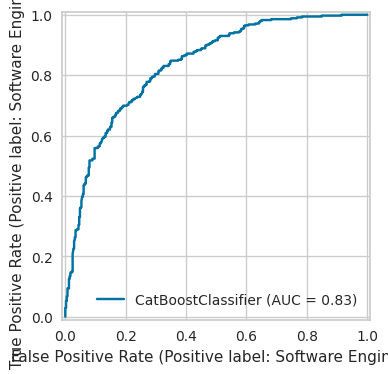

In [54]:
fig, ax = plt.subplots(figsize=(8,4))
metrics.RocCurveDisplay.from_estimator(cb4,
                       X_test, y_test,ax=ax)

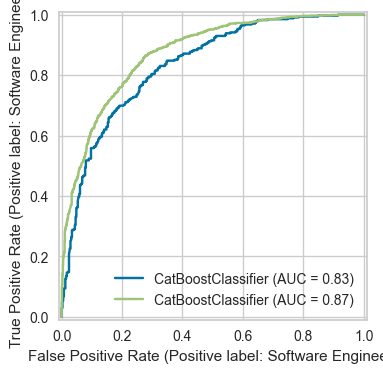

In [51]:
fig, ax = plt.subplots(figsize=(8,4))
metrics.RocCurveDisplay.from_estimator(cb4,
                       X_test, y_test,ax=ax)
metrics.RocCurveDisplay.from_estimator(cb4,
                       X_train, y_train,ax=ax)

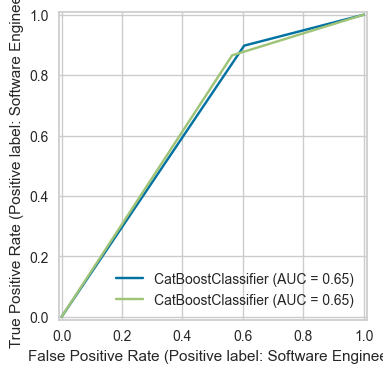

In [55]:
fig, ax = plt.subplots(figsize=(8,4))
metrics.RocCurveDisplay.from_estimator(stump,
                       X_test, y_test,ax=ax)
metrics.RocCurveDisplay.from_estimator(stump,
                       X_train, y_train,ax=ax)

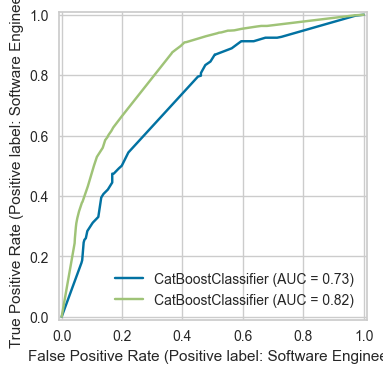

In [56]:
fig, ax = plt.subplots(figsize=(8,4))
metrics.RocCurveDisplay.from_estimator(hi_variance,
                       X_test, y_test,ax=ax)
metrics.RocCurveDisplay.from_estimator(hi_variance,
                       X_train, y_train,ax=ax)

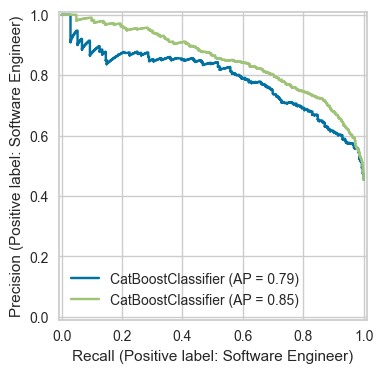

In [52]:
fig, ax = plt.subplots(figsize=(8,4))
metrics.PrecisionRecallDisplay.from_estimator(cb4,
                       X_test, y_test,ax=ax)
metrics.PrecisionRecallDisplay.from_estimator(cb4,
                       X_train, y_train,ax=ax)

## Tuning

Tune for differeent metrics

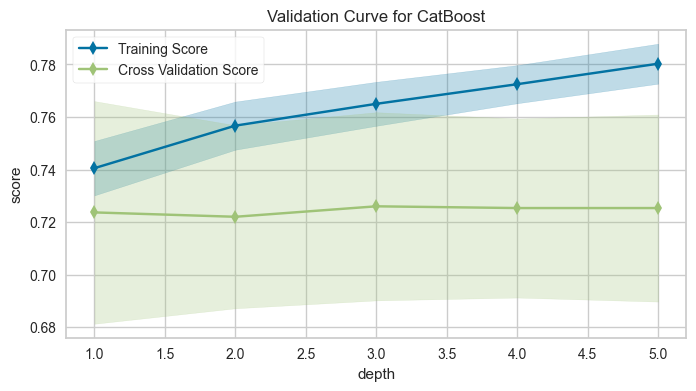

ValidationCurve(ax=<AxesSubplot: title={'center': 'Validation Curve for CatBoost'}, xlabel='depth', ylabel='score'>,
                estimator=<catboost.core.CatBoostClassifier object at 0x294f268f0>,
                param_name='depth', param_range=array([1, 2, 3, 4, 5]))

In [57]:
# takes about 45 seconds to run
import matplotlib.pyplot as plt
from yellowbrick import model_selection as ms
from yellowbrick.utils import types, helpers
from yellowbrick import base

base.get_model_name = lambda model: 'CatBoost'
#helpers.is_esitmator = lambda model: print(f'calling {model=}') or True

fig, ax = plt.subplots(figsize=(8,4))
ms.validation_curve(catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False),
                    X, y, param_name='depth', param_range=range(1,6))
            

/Users/matt/.envs/menv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/matt/.envs/menv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/Users/matt/.envs/menv/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/Users/matt/.envs/menv/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 345, in _score
    y_pred = method_caller(
  File "/Users/matt/.envs/menv/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 87, in _cached_call
    result, _ = _get_response_values(
  File "/Users/matt/.envs/menv/lib/python3.10/site-packages/sklearn/utils/_respon

KeyboardInterrupt: 

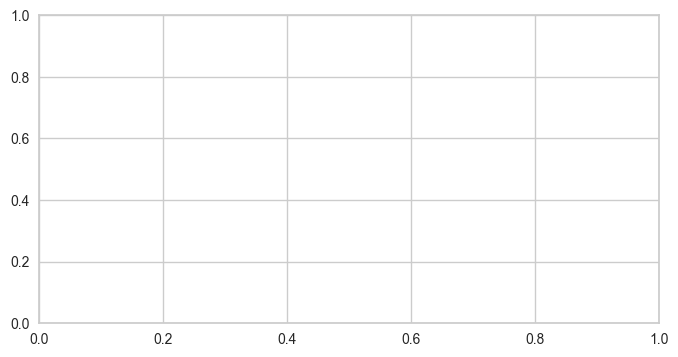

In [60]:
fig, ax = plt.subplots(figsize=(8,4))
ms.validation_curve(catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False),
                    X, y, param_name='depth', param_range=range(1,6),
                    scoring='recall', pos_label='Software Engineer')
            

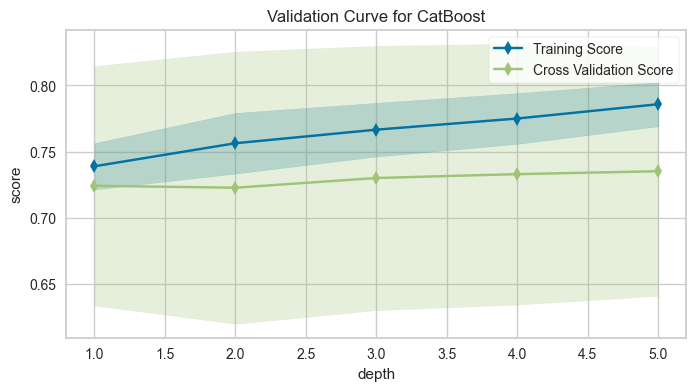

ValidationCurve(ax=<AxesSubplot: title={'center': 'Validation Curve for CatBoost'}, xlabel='depth', ylabel='score'>,
                estimator=<catboost.core.CatBoostClassifier object at 0x294912260>,
                param_name='depth', param_range=array([1, 2, 3, 4, 5]),
                scoring='recall')

In [62]:
fig, ax = plt.subplots(figsize=(8,4))
ms.validation_curve(catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False),
                    X, y=='Software Engineer', param_name='depth', param_range=range(1,6),
                    scoring='recall')
            

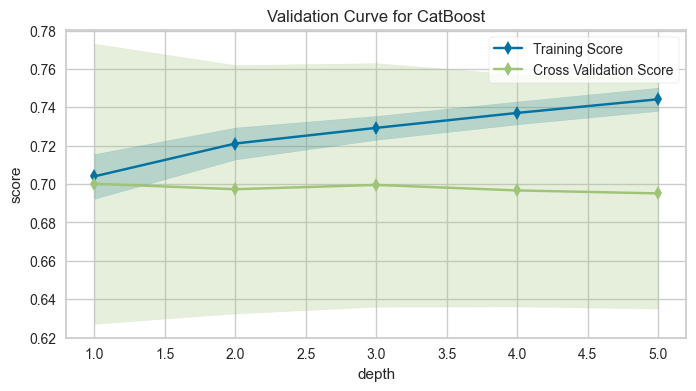

ValidationCurve(ax=<AxesSubplot: title={'center': 'Validation Curve for CatBoost'}, xlabel='depth', ylabel='score'>,
                estimator=<catboost.core.CatBoostClassifier object at 0x2929cc100>,
                param_name='depth', param_range=array([1, 2, 3, 4, 5]),
                scoring='precision')

In [63]:
fig, ax = plt.subplots(figsize=(8,4))
ms.validation_curve(catboost.CatBoostClassifier(cat_features=list(X_train.columns), verbose=False),
                    X, y=='Software Engineer', param_name='depth', param_range=range(1,6),
                    scoring='precision')
            

## Model Interpretation

In [56]:
params = {'bagging_temperature': 0,
 'l2_leaf_reg': 2,
 'learning_rate': 0.1,
 'n_estimators': 200,
 'one_hot_max_size': 1,
 'random_strength': 0.5}
cb4 = catboost.CatBoostClassifier(**params, cat_features=list(X_train.columns), verbose=False)
cb4.fit(X_train, y_train)
cb4.score(X_test, y_test)

0.7480106100795756

In [57]:
cb4.feature_importances_

array([ 4.63112693, 10.85965547,  7.20683806, 10.20558954, 13.51162323,
       14.90159561, 15.04718663,  5.38059385, 11.91710208,  6.3386886 ])

In [58]:
pd.Series(cb4.feature_importances_, index=X_train.columns)

gender           4.631127
age             10.859655
country          7.206838
education       10.205590
major           13.511623
years_exp       14.901596
compensation    15.047187
python           5.380594
r               11.917102
sql              6.338689
dtype: float64

<Axes: >

findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the fo

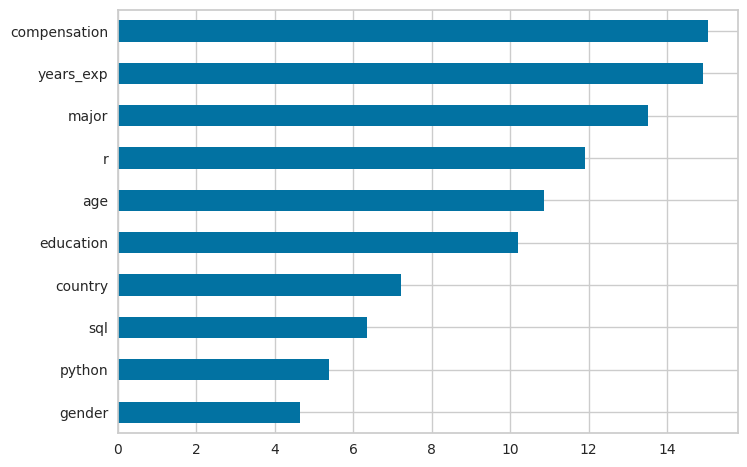

In [59]:
(pd.Series(cb4.feature_importances_, index=X_train.columns)
 .sort_values()
 .plot.barh()
)

<Axes: >

findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the fo

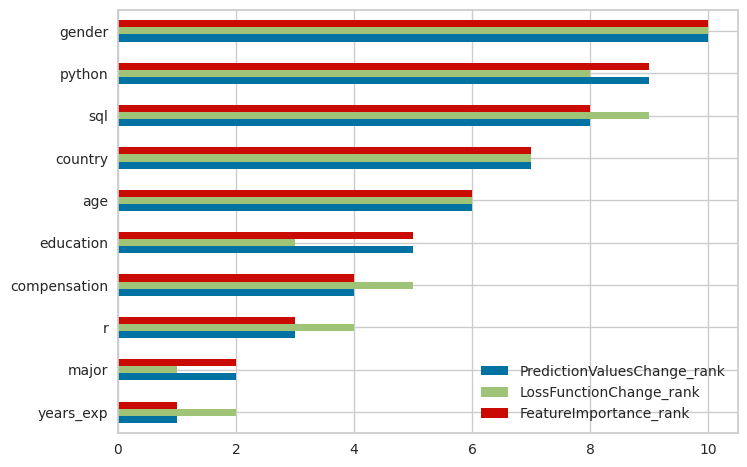

In [60]:
def add_ranks(df_):
    return (df_
            .assign(**{f'{col}_rank':df_[col].rank(ascending=False) for col in 
                     df_.columns})
           )
    
pool = catboost.Pool(X_train, y_train, cat_features=list(X_train.columns))
(pd.DataFrame({typ:cb4.get_feature_importance(type=typ, data=pool)
             for typ in ['PredictionValuesChange',
                        'LossFunctionChange',
                'FeatureImportance', 
                         #'ShapValues',
        #'ShapInteractionValues',
        #'Interaction',
        #'PredictionDiff',
        #'SageValues'
                        ]},
            index=X_train.columns)
 .pipe(add_ranks)
 .sort_values(by='FeatureImportance_rank')
 .loc[:, 'PredictionValuesChange_rank':]
 .plot.barh()
)

## SHAP (SHapley Additive exPlantations)
Should be *globally* consistent and accurate

 Shapley value (SHAP).
 
 From game theory, indicates how to distribute attribution of label



In [63]:
import shap
shap.initjs()

# make sure you initialize the js side
shap_ex = shap.TreeExplainer(cb4)
vals = shap_ex(X_test)

/workspaces/odsc_west_2024/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [64]:
vals

.values =
array([[-0.0190726 ,  0.09869448,  0.01862894, ..., -0.12189119,
         0.37766515,  0.01937879],
       [-0.01019819, -0.20278468, -0.15298832, ..., -0.12871802,
         0.25525594, -0.1473566 ],
       [ 0.05339003, -0.45755154, -0.06362794, ..., -0.13582594,
        -0.70431727, -0.04439922],
       ...,
       [-0.07175962,  0.21218516, -0.08232507, ..., -0.06947316,
        -0.62089968,  0.1180829 ],
       [ 0.02913489,  0.12238483,  0.39940336, ...,  0.23994936,
         0.2922695 , -0.08299787],
       [-0.05259053, -0.18465173, -0.06647955, ..., -0.13372037,
        -0.75433874,  0.05655964]])

.base_values =
array([-0.32383175, -0.32383175, -0.32383175, -0.32383175, -0.32383175,
       -0.32383175, -0.32383175, -0.32383175, -0.32383175, -0.32383175,
       -0.32383175, -0.32383175, -0.32383175, -0.32383175, -0.32383175,
       -0.32383175, -0.32383175, -0.32383175, -0.32383175, -0.32383175,
       -0.32383175, -0.32383175, -0.32383175, -0.32383175, -0.32383175,
 

findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the fo

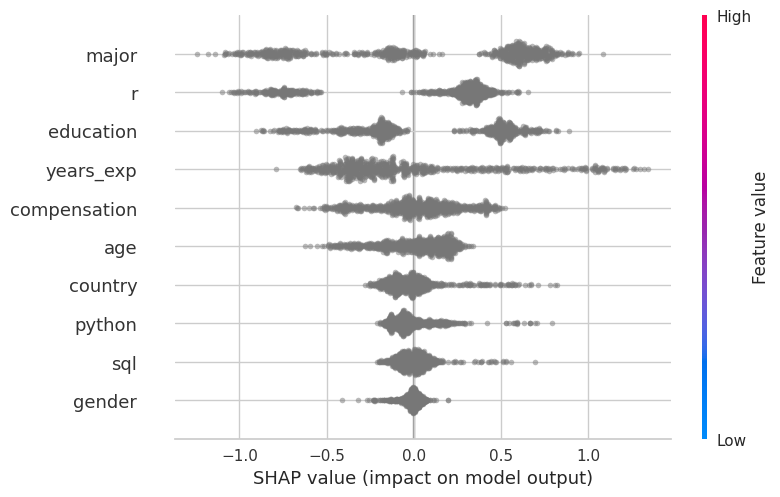

In [65]:
shap.plots.beeswarm(vals, alpha=.5)

TypeError: unsupported operand type(s) for -: 'str' and 'str'

findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Generic family 'sans-serif' not found because none of the fo

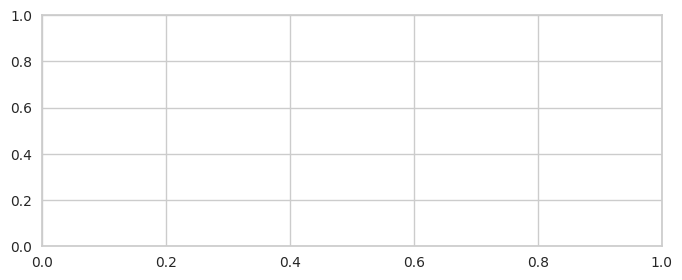

In [ ]:
# specify interaction
fig, ax = plt.subplots(figsize=(8,3))
shap.plots.scatter(vals[:,'major'])#, color=vals[:, 'education'], ax=ax, x_jitter=.5, alpha=.5)  

In [68]:
# shap doesn't like categories 😭
import seaborn as sns

(pd.DataFrame(vals.values, columns=X_test.columns, index=X_test.index)
 .rename(columns=lambda col: f'{col}_shap')
 .assign(base_values=vals.base_values, **X_test)
 .pipe(lambda df_:
       sns.catplot(y='major', x='major_shap', data=df_, 
                   aspect=2, height=10,
                   #hue='education'
                  )
      )
)

ModuleNotFoundError: No module named 'seaborn'

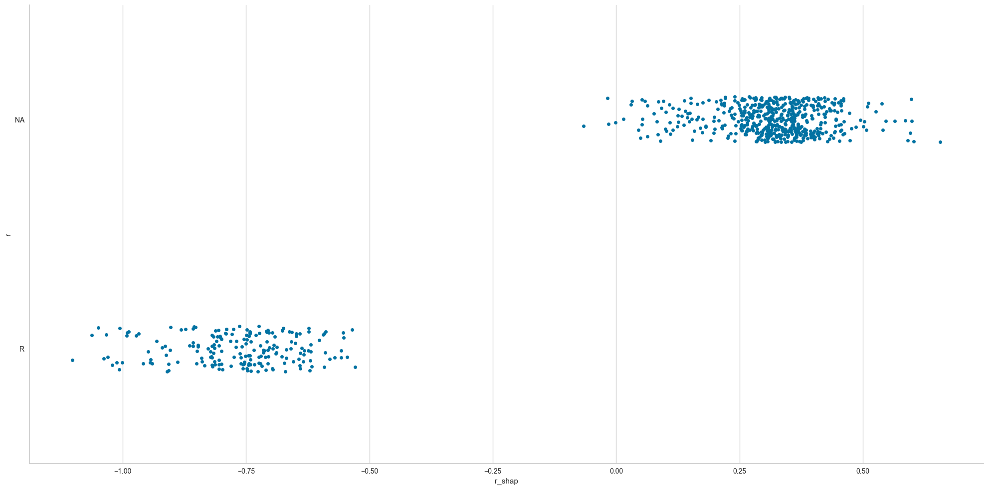

In [68]:
# shap doesn't like categories 😭
import seaborn as sns

(pd.DataFrame(vals.values, columns=X_test.columns, index=X_test.index)
 .rename(columns=lambda col: f'{col}_shap')
 .assign(base_values=vals.base_values, **X_test)
 .pipe(lambda df_:
       sns.catplot(y='r', x='r_shap', data=df_, 
                   aspect=2, height=10,
                   #hue='education'
                  )
      )
)

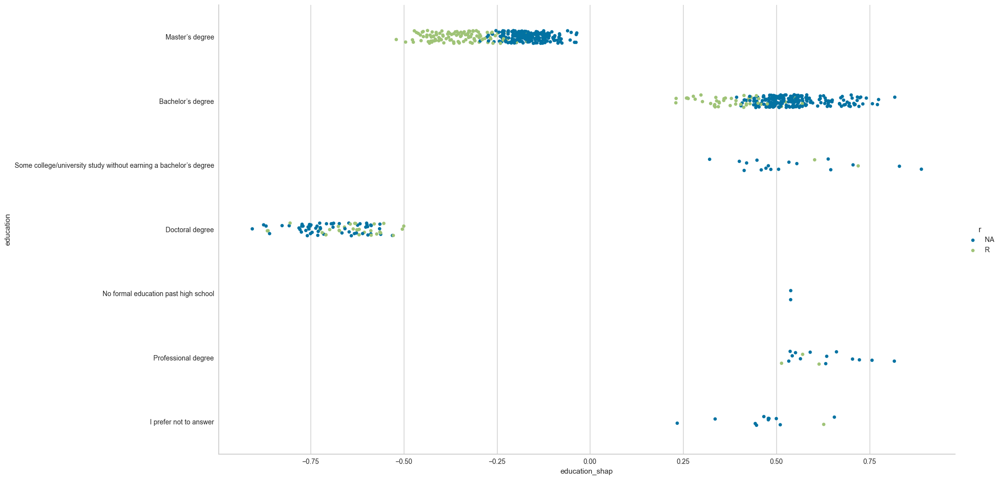

In [69]:
# shap doesn't like categories 😭
import seaborn as sns

(pd.DataFrame(vals.values, columns=X_test.columns, index=X_test.index)
 .rename(columns=lambda col: f'{col}_shap')
 .assign(base_values=vals.base_values, **X_test)
 .pipe(lambda df_:
       sns.catplot(y='education', x='education_shap', data=df_, 
                   aspect=2, height=10,
                   hue='r'
                  )
      )
)

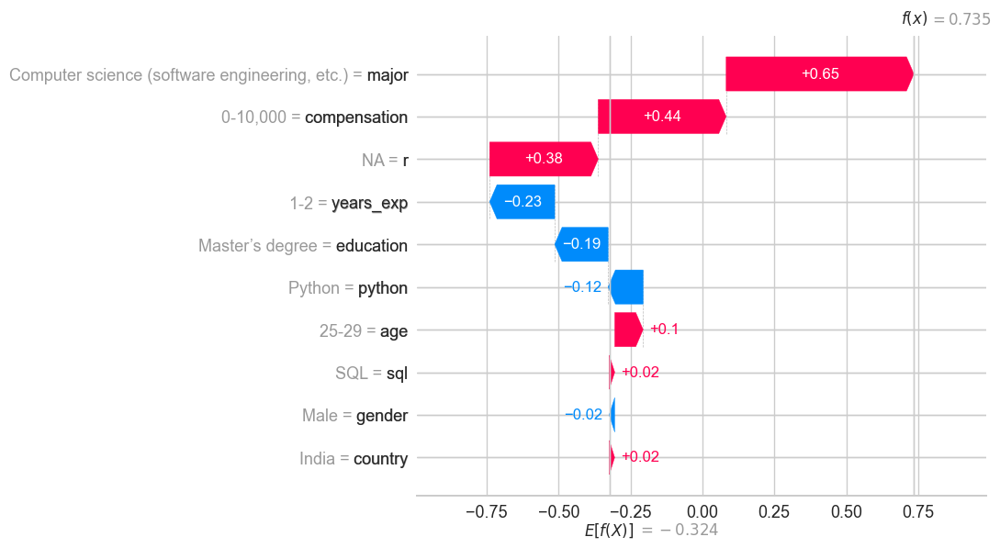

In [70]:
# blue - DS
# red - SE

shap.initjs()
shap.plots.waterfall(vals[0])

In [71]:
cb4.predict(X_test.iloc[[0]])

array(['Software Engineer'], dtype=object)

In [72]:
X_test.iloc[[0]]

,gender,age,country,education,major,years_exp,compensation,python,r,sql
5525,Male,25-29,India,Master’s degree,"Computer science (software engineering, etc.)",1-2,"0-10,000",Python,NA,SQL


# Summary

CatBoost is very powerful.

Explore your data and your results.

Suggestions:

* Pandas skills come in useful for manipulating data
* Make sure you discuss business value with stake holders


Questions?


Connect on LinkedIn or Twitter `@__mharrison__`